In [75]:
import tifffile

from matplotlib import pyplot as plt
%matplotlib inline

In [76]:
#%%
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

from tqdm.auto import tqdm
import os

In [77]:
import os
base_folder = '/mnt/LSDF/projects/code-vita/BM_beamtimes/2022_02_P23/27-02/trichogramma/001/'

In [78]:
after = tifffile.imread(os.path.join(base_folder, 'pr-pag-all-denoised', 'scan_0106-pr-pag-2p0.tif'))

In [36]:
before = tifffile.imread(os.path.join(base_folder, 'pr-pag-all', 'scan_0106-pr-pag-2p0.tif'))

In [24]:
after_old = tifffile.imread(os.path.join(base_folder, 'scan_0106/pr-pag/img-new-corr.tif'))

In [38]:
after_noise = tifffile.imread(os.path.join(base_folder, 'pr-pag-all-denoised', 'scan_0106-pr-pag-2p0.tif'))

In [40]:
paganoise = tifffile.imread('/mnt/data/denoising/paganin_noise_collection.tif')

In [12]:
i = 5919

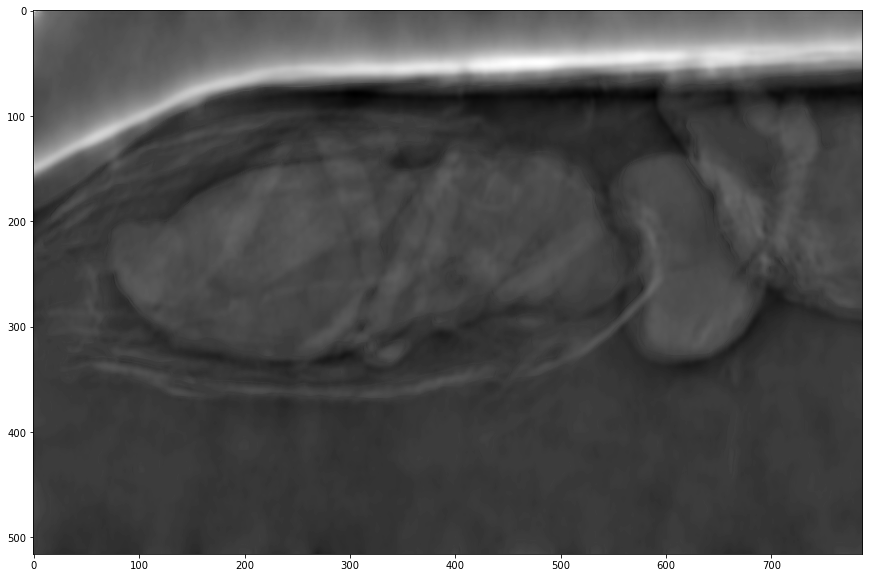

In [27]:
plt.figure(figsize=(16, 10))
plt.imshow(after[i], cmap='gray')

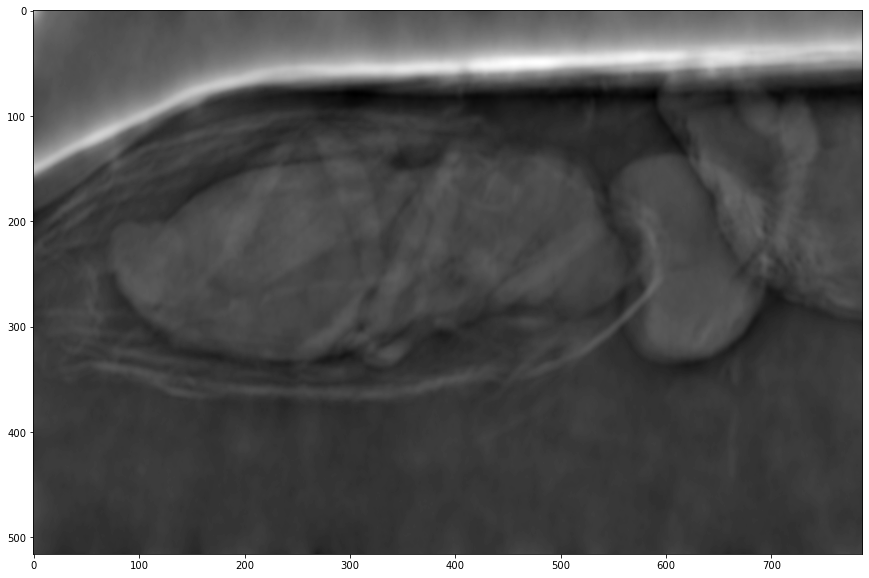

In [28]:
plt.figure(figsize=(16, 10))
plt.imshow(before[i], cmap='gray')

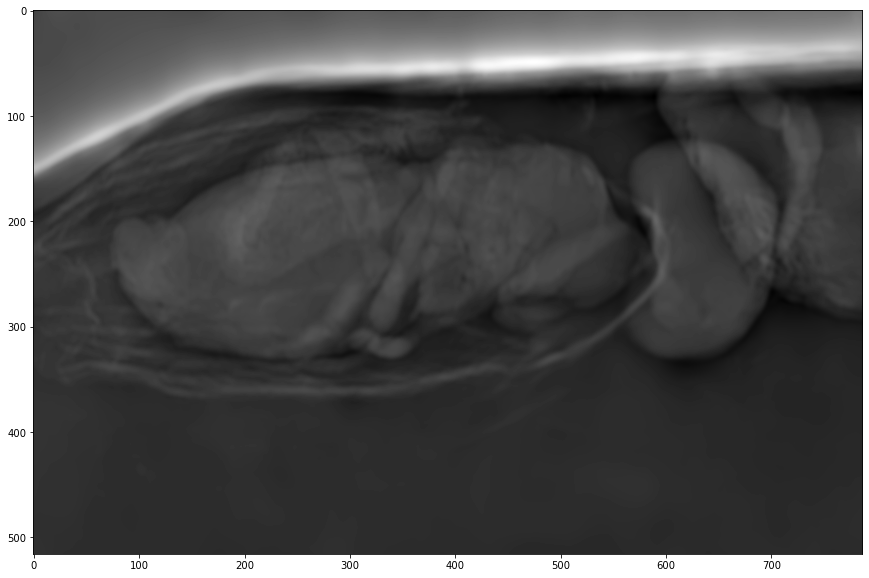

In [29]:
plt.figure(figsize=(16, 10))
plt.imshow(after_old[i], cmap='gray')

In [47]:
import torch

In [67]:
a = torch.FloatTensor(after[0])

In [69]:
a.requires_grad = True

In [71]:
b = torch.fft.rfft2(a)

In [72]:
c = torch.fft.irfft2(b)

In [73]:
c.mean().backward()

In [74]:
a.grad

tensor([[2.4656e-06, 2.4656e-06, 2.4656e-06,  ..., 2.4656e-06, 2.4656e-06,
         2.4656e-06],
        [2.4656e-06, 2.4656e-06, 2.4656e-06,  ..., 2.4656e-06, 2.4656e-06,
         2.4656e-06],
        [2.4656e-06, 2.4656e-06, 2.4656e-06,  ..., 2.4656e-06, 2.4656e-06,
         2.4656e-06],
        ...,
        [2.4656e-06, 2.4656e-06, 2.4656e-06,  ..., 2.4656e-06, 2.4656e-06,
         2.4656e-06],
        [2.4656e-06, 2.4656e-06, 2.4656e-06,  ..., 2.4656e-06, 2.4656e-06,
         2.4656e-06],
        [2.4656e-06, 2.4656e-06, 2.4656e-06,  ..., 2.4656e-06, 2.4656e-06,
         2.4656e-06]])

In [79]:
from matplotlib import animation
from IPython.display import HTML

CalledProcessError: Command '['ffmpeg', '-f', 'rawvideo', '-vcodec', 'rawvideo', '-s', '1152x720', '-pix_fmt', 'rgba', '-r', '50.0', '-loglevel', 'error', '-i', 'pipe:', '-vcodec', 'h264', '-pix_fmt', 'yuv420p', '-y', '/tmp/tmp1obflx35/temp.m4v']' returned non-zero exit status 255.

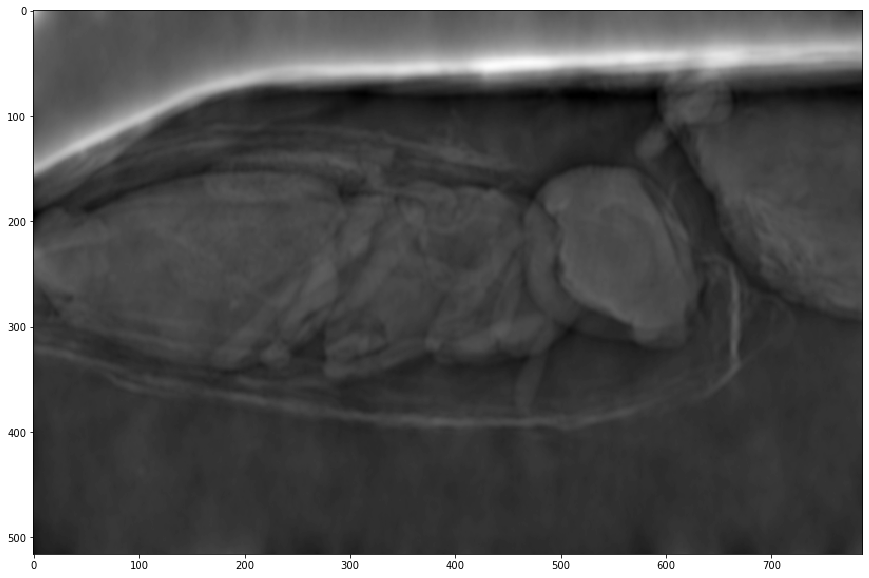

In [80]:
%%time
fig = plt.figure(figsize=(16, 10))

im=plt.imshow(before[0], interpolation='none', cmap='gray')

def draw_one(n):
    im.set_array(before[n])
    
    return (im,)

anim = animation.FuncAnimation(fig, draw_one, frames=range(3_000, 6_000), interval=20, blit=True)

HTML(anim.to_html5_video())

In [ ]:
%%time
fig = plt.figure(figsize=(16, 10))

im=plt.imshow(after[0], interpolation='none', cmap='gray')

def draw_one(n):
    im.set_array(after[n])
    
    return (im,)

anim = animation.FuncAnimation(fig, draw_one, frames=range(3_000, 6_000), interval=20, blit=True)

HTML(anim.to_html5_video())

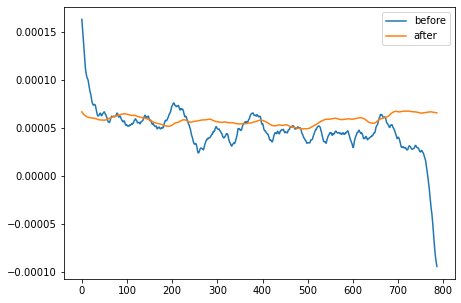

In [175]:
plt.figure(figsize=(7, 5))
plt.plot(before_pr[0, 500, :], label='before')
plt.plot(after_pr_best[0, 500, :], label='after')
plt.legend()
plt.show()

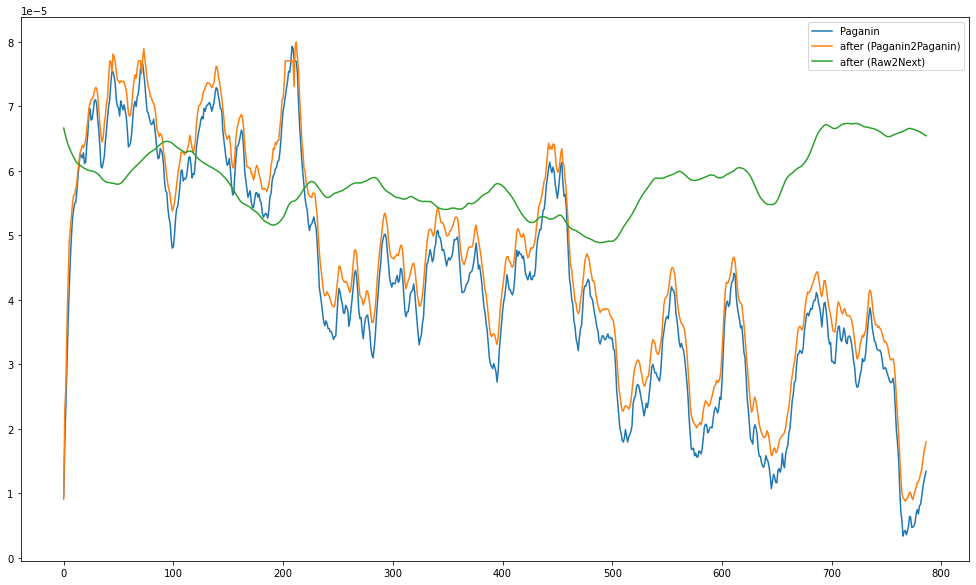

In [44]:
plt.figure(figsize=(17, 10))
plt.plot(before[0, 500, :], label='Paganin')
plt.plot(after[0, 500, :], label='after (Paganin2Paganin)')
plt.plot(after_old[0, 500, :], label='after (Raw2Next)')
plt.legend()
plt.show()

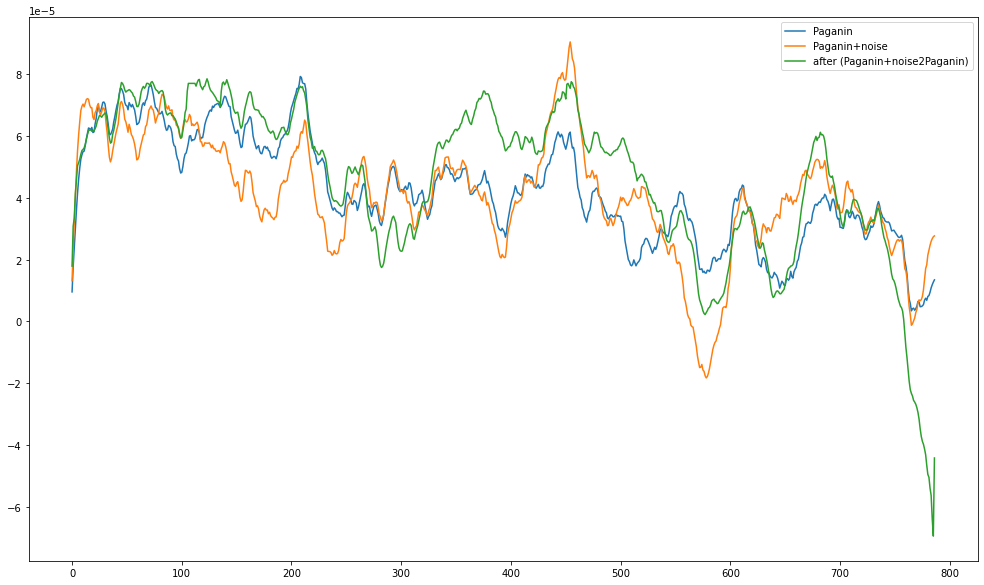

In [46]:
plt.figure(figsize=(17, 10))
plt.plot(before[0, 500, :], label='Paganin')
plt.plot(before[0, 500, :] + paganoise[0, 500, :], label='Paganin+noise')
# plt.plot(after[0, 500, :], label='after (Paganin2Paganin)')
plt.plot(after_noise[0, 500, :], label='after (Paganin+noise2Paganin)')
# plt.plot(after_old[0, 500, :], label='after (Raw2Next)')
plt.legend()
plt.show()

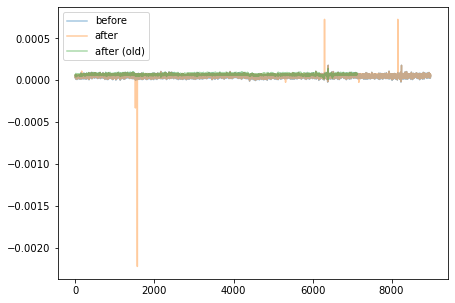

In [32]:
plt.figure(figsize=(7, 5))
plt.plot(before[:-10, 500, 700], alpha=0.4, label='before')
plt.plot(after[:-10, 500, 700], alpha=0.4, label='after')
plt.plot(after_old[:-10, 500, 700], alpha=0.4, label='after (old)')
plt.legend();

In [149]:
%%time
#before
HTML(anim.to_html5_video())

CPU times: user 2min 47s, sys: 5.73 s, total: 2min 52s
Wall time: 2min 58s


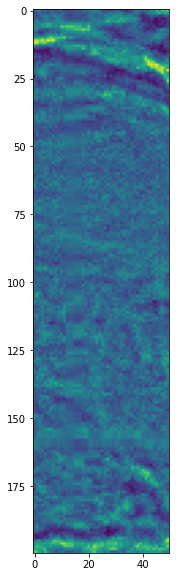

In [32]:
plt.figure(figsize=(16, 10))
plt.imshow(before[i+1][100:300, 250:300])

In [34]:
from skimage.filters import gaussian

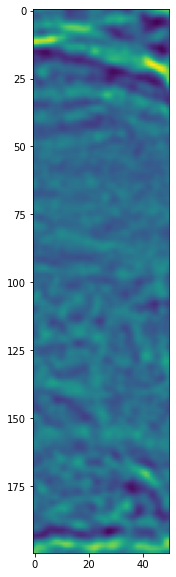

In [40]:
plt.figure(figsize=(16, 10))
plt.imshow(gaussian(before[i+1], sigma=1)[100:300, 250:300])

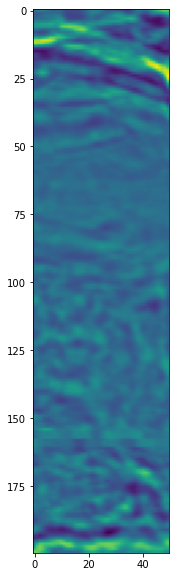

In [33]:
plt.figure(figsize=(16, 10))
plt.imshow(after[i][100:300, 250:300])

In [12]:
after_dc = tifffile.imread('/mnt/LSDF/projects/code-vita/BM_beamtimes/2022_02_P23/27-02/trichogramma/001/scan_0106/ffcorr_corr_dead_px/denoised_dc_scan_0106.tif')

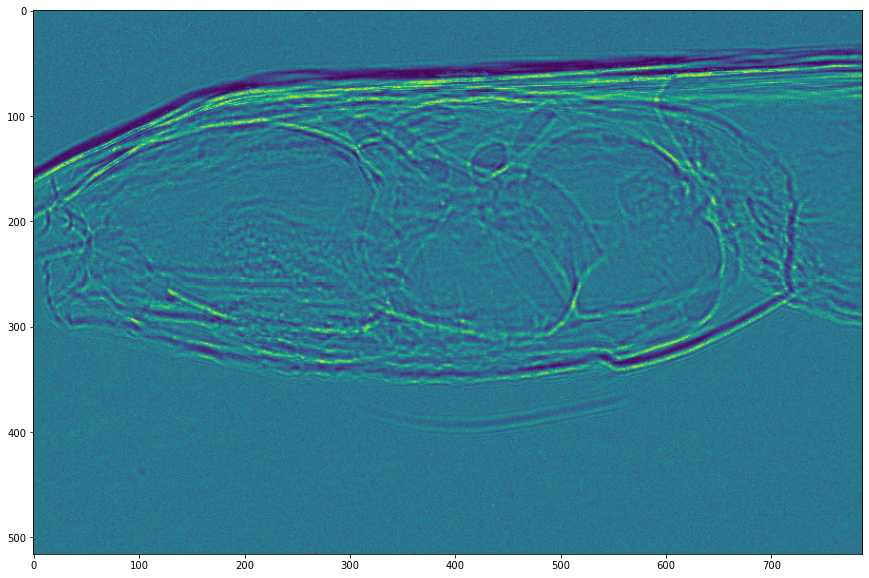

In [8]:
plt.figure(figsize=(16, 10))
plt.imshow(before[i:i+2].mean(0))

In [44]:
!cp /mnt/LSDF/projects/code-vita/BM_beamtimes/2022_02_P23/27-02/trichogramma/001/scan_0106/denoising-comparison/pr-pag-8bit.avi .
!cp /mnt/LSDF/projects/code-vita/BM_beamtimes/2022_02_P23/27-02/trichogramma/001/scan_0106/denoising-comparison/pr-pag-denoised-8bit.avi .

In [7]:
ls /mnt/LSDF/projects/code-vita/BM_beamtimes/2022_02_P23/27-02/trichogramma/036/scan_*/pr-pag/pr-pag-2p0.tif

/mnt/LSDF/projects/code-vita/BM_beamtimes/2022_02_P23/27-02/trichogramma/036/scan_0001/pr-pag/pr-pag-2p0.tif*
/mnt/LSDF/projects/code-vita/BM_beamtimes/2022_02_P23/27-02/trichogramma/036/scan_0002/pr-pag/pr-pag-2p0.tif*
/mnt/LSDF/projects/code-vita/BM_beamtimes/2022_02_P23/27-02/trichogramma/036/scan_0003/pr-pag/pr-pag-2p0.tif*


In [27]:
a = tifffile.imread(os.path.join(base_folder, '001/pr-pag-all/scan_0106-pr-pag-2p0.tif'))

In [55]:
a = tifffile.imread(os.path.join(base_folder, '001/scan_0106/pr-pag/img-corr-bad-px-reg2p0.tif'))

In [54]:
b = tifffile.imread(os.path.join(base_folder, '041/scan_0001/pr-pag/pr-pag-2p0.tif'))

FileNotFoundError: [Errno 2] No such file or directory: '/autofs/LSDF/projects/code-vita/BM_beamtimes/2022_02_P23/27-02/trichogramma/041/scan_0001/pr-pag/img-no-corr-bad-px.tif'

In [38]:
a.shape, before.shape

((8997, 516, 787), (7142, 516, 787))

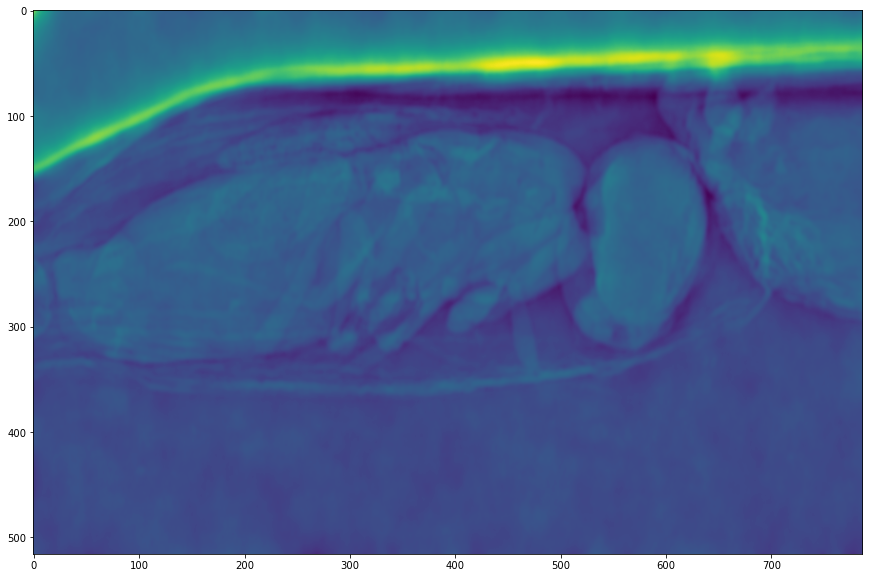

In [56]:
plt.figure(figsize=(16, 10))
plt.imshow(a[0])